# Geo Data: A Data Scientist's perspective

## Intro: Does geo actually matter?

- In 1854 London faced a sudden and severe Cholera outbreak
- In the world of the 1850s it was believed that cholera was airborne
- Dr. John Snow (englisch Surgeon) did not accept this theory wanted to prove it wrong with data

<img align="left" src="images/deaths_list.jpeg" width=300 />
<img align="center" src="images/map_soho.png" width=500 />

## Non-explicitly modelling of geo information

In [31]:
# dealing with datasets in Python
import pandas as pd
import geopandas as gpd
import numpy as np

pd.set_option('display.float_format', lambda x: '%.3f' % x)

# load osm data
import osmnx as ox

# visualization of spatial data
import folium
from folium import plugins
from shapely import wkt

import seaborn as sns

# Python ML
import xgboost as xgb
from sklearn.metrics import median_absolute_error
import shap
from sklearn.model_selection import train_test_split


import warnings
warnings.filterwarnings('ignore')

from modules import *
from modules import get_performance, train_model_lr

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# Read & prep data
df_housing = read_prep_data()
df_housing.head()

,rooms,price,bedroom2,bathroom,car,landsize,buildingarea,yearbuilt,lattitude,longtitude,year
0,2,1480000.000,2.000,1.000,1.000,202.000,NaN,NaN,-37.800,144.998,2016
1,2,1035000.000,2.000,1.000,0.000,156.000,79.000,1900.000,-37.808,144.993,2016
2,3,1465000.000,3.000,2.000,0.000,134.000,150.000,1900.000,-37.809,144.994,2017
3,3,850000.000,3.000,2.000,1.000,94.000,NaN,NaN,-37.797,144.997,2017
4,4,1600000.000,3.000,1.000,2.000,120.000,142.000,2014.000,-37.807,144.994,2016


In [3]:
# Create GeoDataFrame
gdf = gpd.GeoDataFrame(
    df_housing, geometry=gpd.points_from_xy(df_housing.longtitude, df_housing.lattitude))
gdf.head()

,rooms,price,bedroom2,bathroom,car,landsize,buildingarea,yearbuilt,lattitude,longtitude,year,geometry
0,2,1480000.000,2.000,1.000,1.000,202.000,NaN,NaN,-37.800,144.998,2016,POINT (144.99840 -37.79960)
1,2,1035000.000,2.000,1.000,0.000,156.000,79.000,1900.000,-37.808,144.993,2016,POINT (144.99340 -37.80790)
2,3,1465000.000,3.000,2.000,0.000,134.000,150.000,1900.000,-37.809,144.994,2017,POINT (144.99440 -37.80930)
3,3,850000.000,3.000,2.000,1.000,94.000,NaN,NaN,-37.797,144.997,2017,POINT (144.99690 -37.79690)
4,4,1600000.000,3.000,1.000,2.000,120.000,142.000,2014.000,-37.807,144.994,2016,POINT (144.99410 -37.80720)


In [4]:
# Check coordinate system
print(gdf.crs)

None


In [5]:
# Add coordinate system for World Geodetic System 1984 (WGS 84)
gdf = gdf.set_crs("EPSG:4326")

In [6]:
# Check coordinate system
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [7]:
# Create interactive folium plot
gdf.explore(
    column="price",
    tooltip=["price"],
    popup=True,
    marker_kwds=dict(radius=4, fill=True, opacity=0.8),
    tiles="CartoDB positron",
    name="price",
)

In [8]:
# Descriptive stats
gdf.describe()

,rooms,price,bedroom2,bathroom,car,landsize,buildingarea,yearbuilt,lattitude,longtitude,year
count,20993.000,20993.000,20784.000,20778.000,20401.000,17960.000,10647.000,12076.000,20993.000,20993.000,20993.000
mean,3.059,1089746.175,3.046,1.591,1.715,593.749,156.862,1966.592,-37.807,144.997,2016.818
std,0.950,653028.264,0.955,0.701,0.995,3759.539,449.409,36.752,0.092,0.121,0.628
min,1.000,85000.000,0.000,0.000,0.000,0.000,0.000,1196.000,-38.190,144.424,2016.000
25%,2.000,657000.000,2.000,1.000,1.000,219.000,100.000,1950.000,-37.861,144.925,2016.000
50%,3.000,910000.000,3.000,1.000,2.000,512.000,133.000,1970.000,-37.800,145.003,2017.000
75%,4.000,1335000.000,4.000,2.000,2.000,664.000,182.000,2000.000,-37.749,145.069,2017.000
max,16.000,11200000.000,20.000,9.000,18.000,433014.000,44515.000,2019.000,-37.398,145.526,2018.000


In [34]:
gdf = gdf.dropna()

<AxesSubplot:xlabel='year', ylabel='price'>

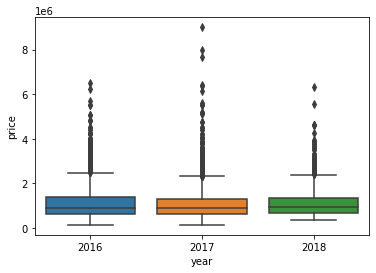

In [35]:
# Check for price variation over time
sns.boxplot(x="year", y="price", data=gdf)

## Create first model without geo information

In [79]:
# Define features & label
feat_no_geo = [
    'rooms', 'bedroom2','bathroom', 'car',
    'landsize','buildingarea','yearbuilt'
]

label = ['price']

# Train test split
X_train, X_test, y_train, y_test = train_test_split(gdf[feat_no_geo], gdf[label], test_size=0.33, random_state=3)

# Fit model without geo information
model_no_geo = train_model_xgb(X_train, y_train)

# Add residuals
gdf["residuals_no_geo"] = res_predict(model_no_geo, gdf[feat_no_geo], gdf[label])

# Plot performance
get_performance(model_no_geo, X_train,y_train, X_test,y_test)

MAE on training data: 108900.0
MAE on test data: 191552.19


In [77]:
# Define features & label
feat_no_geo = [
    'rooms', 'bedroom2','bathroom', 'car',
    'landsize','buildingarea','yearbuilt', 'lattitude', 'longtitude'
]

label = ['price']

# Train test split
X_train, X_test, y_train, y_test = train_test_split(gdf[feat_no_geo], gdf[label], test_size=0.33, random_state=3)

# Fit model without geo information
model_no_geo = train_model_xgb(X_train, y_train)

# Add residuals
gdf["residuals_no_geo"] = res_predict(model_no_geo, gdf[feat_no_geo], gdf[label])

# Plot performance
get_performance(model_no_geo, X_train,y_train, X_test,y_test)

MAE on training data: 52739.0
MAE on test data: 107613.25


In [71]:
# Check residuals
gdf.explore(
    column="residuals_no_geo",
    tooltip=["residuals_no_geo"],
    popup=True,
    marker_kwds=dict(radius=4, fill=True, opacity=0.8),
    tiles="CartoDB positron",
    name="residuals_no_geo",
)

## Add distance feature as proxy for geo information

In [12]:
# Load world polygons
world_filepath = gpd.datasets.get_path('naturalearth_lowres')
world = gpd.read_file(world_filepath)

# Create GeoDataFrame with coastline of australia
world = world.loc[world["name"]=="Australia"]
coast_line = gpd.GeoDataFrame(geometry= world.loc[world["name"]=="Australia"].boundary)
coast_line["name"] = "Australia"

# Plot result
coast_line.plot()

<AxesSubplot:>

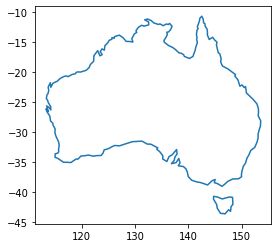

In [13]:
# Create GeoDataFrame with coastline of australia
world = world.loc[world["name"]=="Australia"]
coast_line = gpd.GeoDataFrame(geometry= world.loc[world["name"]=="Australia"].boundary)
coast_line["name"] = "Australia"

# Plot result
coast_line.plot()

In [14]:
# Check crs
coast_line.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [15]:
coast_line

,geometry,name
137,"MULTILINESTRING ((147.68926 -40.80826, 148.289...",Australia


In [16]:
gdf

,rooms,price,bedroom2,bathroom,car,landsize,buildingarea,yearbuilt,lattitude,longtitude,year,geometry,residuals_no_geo
0,2,1480000.000,2.000,1.000,1.000,202.000,NaN,NaN,-37.800,144.998,2016,POINT (144.99840 -37.79960),502309.062
1,2,1035000.000,2.000,1.000,0.000,156.000,79.000,1900.000,-37.808,144.993,2016,POINT (144.99340 -37.80790),-48992.625
2,3,1465000.000,3.000,2.000,0.000,134.000,150.000,1900.000,-37.809,144.994,2017,POINT (144.99440 -37.80930),-28567.125
3,3,850000.000,3.000,2.000,1.000,94.000,NaN,NaN,-37.797,144.997,2017,POINT (144.99690 -37.79690),-210208.000
4,4,1600000.000,3.000,1.000,2.000,120.000,142.000,2014.000,-37.807,144.994,2016,POINT (144.99410 -37.80720),494708.250
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20988,3,1101000.000,3.000,1.000,NaN,288.000,NaN,NaN,-37.811,144.885,2018,POINT (144.88516 -37.81095),78757.750
20989,4,1480000.000,4.000,1.000,3.000,593.000,NaN,NaN,-37.811,144.885,2018,POINT (144.88467 -37.81053),370786.375
20990,2,888000.000,2.000,2.000,1.000,98.000,104.000,2018.000,-37.816,144.888,2018,POINT (144.88826 -37.81551),40818.688
20991,2,705000.000,2.000,1.000,2.000,220.000,120.000,2000.000,-37.823,144.879,2018,POINT (144.87856 -37.82286),-112715.062


In [17]:
# Transform crs to calculate distance in meters
gdf = gdf.to_crs("EPSG:3577")
coast_line = coast_line.to_crs("EPSG:3577")
# Calculate distance between "coastline" and points
gdf['distance_coast'] = gdf.geometry.apply(lambda x: coast_line.distance(x))

<Projected CRS: EPSG:3577>
Name: GDA94 / Australian Albers
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Australia - Australian Capital Territory; New South Wales; Northern Territory; Queensland; South Australia; Tasmania; Western Australia; Victoria.
- bounds: (112.85, -43.7, 153.69, -9.86)
Coordinate Operation:
- name: Australian Albers
- method: Albers Equal Area
Datum: Geocentric Datum of Australia 1994
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [18]:
# Calculate distance between "coastline" and points
gdf['distance_calc'] = gdf.geometry.apply(lambda x: coast_line.distance(x))

In [19]:
# Check dist calculation

m = coast_line.explore(
    column='name',
    tiles="CartoDB positron",
    name="coast_line"
)


gdf.explore(
    m=m,
    column='distance_calc',
    popup=True,
    marker_kwds=dict(radius=4, fill=True, opacity=0.8),
    name="distance"
)


folium.LayerControl().add_to(m) 

m

## Create model with geo feature

In [78]:
# Define features & label
feat_geo = [
    'rooms', 'bedroom2','bathroom', 'car',
    'landsize','buildingarea','yearbuilt', 'distance_calc', 'lattitude', 'longtitude'
]

label = ['price']

# Train test split
X_train_geo, X_test_geo, y_train_geo, y_test_geo = train_test_split(gdf[feat_geo], gdf[label], test_size=0.33, random_state=3)

# Fit model without geo information
model_geo = train_model_xgb(X_train_geo, y_train_geo)

# Add residuals
gdf["residuals_geo"] = res_predict(model_geo, gdf[feat_geo], gdf[label])

# Plot performance
get_performance(model_geo, X_train_geo,y_train_geo, X_test_geo,y_test_geo)

MAE on training data: 48684.0
MAE on test data: 104580.44


In [69]:
# Check residuals with geo
gdf.explore(
    column="residuals_geo",
    tooltip=["residuals_geo"],
    popup=True,
    marker_kwds=dict(radius=4, fill=True, opacity=0.8),
    tiles="CartoDB positron",
    name="residuals_geo",
)

## Other geo processing  

### Spatial joins

In [22]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
countries = world[['geometry', 'name']]
cities = gpd.read_file(gpd.datasets.get_path('naturalearth_cities'))

In [23]:
countries.head()

,geometry,name
0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji
1,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania
2,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948...",W. Sahara
3,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada
4,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States of America


In [24]:
cities.head()

,name,geometry
0,Vatican City,POINT (12.45339 41.90328)
1,San Marino,POINT (12.44177 43.93610)
2,Vaduz,POINT (9.51667 47.13372)
3,Luxembourg,POINT (6.13000 49.61166)
4,Palikir,POINT (158.14997 6.91664)


In [25]:
cities_with_country = cities.sjoin(countries, how="inner", predicate='intersects')
cities_with_country 

,name_left,geometry,index_right,name_right
0,Vatican City,POINT (12.45339 41.90328),141,Italy
1,San Marino,POINT (12.44177 43.93610),141,Italy
192,Rome,POINT (12.48131 41.89790),141,Italy
2,Vaduz,POINT (9.51667 47.13372),114,Austria
184,Vienna,POINT (16.36469 48.20196),114,Austria
...,...,...,...,...
195,Jakarta,POINT (106.82749 -6.17247),8,Indonesia
196,Bogota,POINT (-74.08529 4.59837),32,Colombia
197,Cairo,POINT (31.24802 30.05191),163,Egypt
198,Tokyo,POINT (139.74946 35.68696),155,Japan


## Further ressources
- **[Tutorials on advanced spatial analysis](https://geographicdata.science/book/intro.html)**
- **[Package for spatial analysis](https://github.com/pysal)**
- **[Long list of geospatial packages](https://github.com/sacridini/Awesome-Geospatial)**